## Advanced Lane Finding Project 

The goals / steps of this project are the following:
* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## Camera Calibration

Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

In [1]:
# prepare libaries
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import pickle

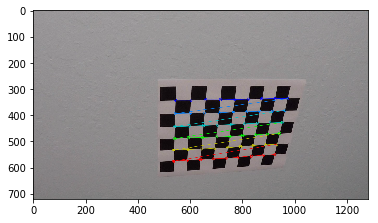

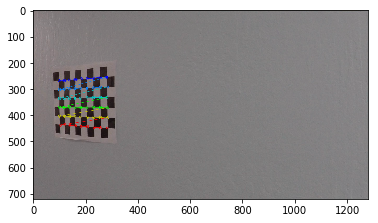

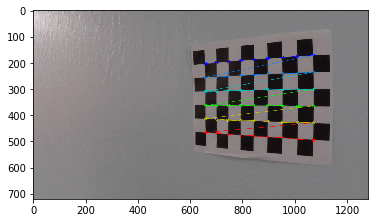

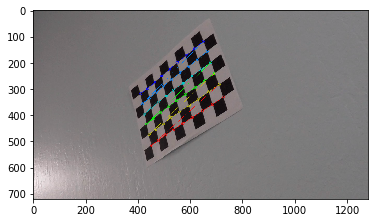

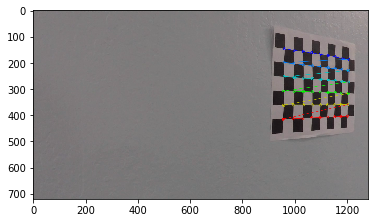

...

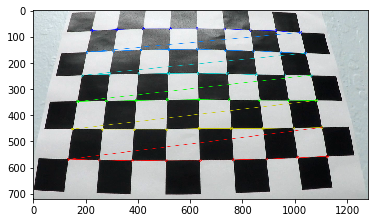

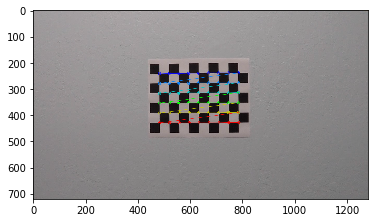

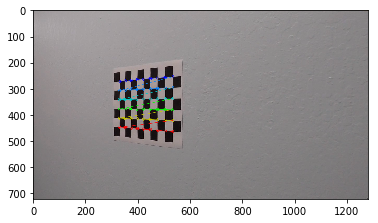

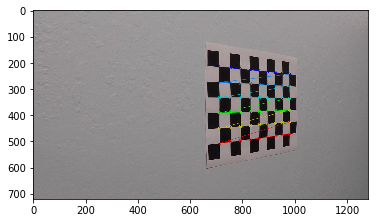

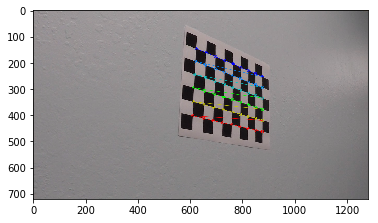

In [2]:
# Calibrate camera and save obj and image points to file 'calibration_image_points.p'
#
# Make a list of calibration images
def gete_calibration_image_list( x, y, file_name_patterns ):
    
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((y*x,3), np.float32)
    objp[:,:2] = np.mgrid[0:x,0:y].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    images = glob.glob( file_name_patterns )

    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (x,y),None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (x,y), corners, ret)
                        
            plt.figure()
            plt.imshow(img)

    return objpoints, imgpoints

# create image list
objpoints, imgpoints = gete_calibration_image_list( 9, 6, '../camera_cal/calibration*.jpg' )

# create a dictionary to dump to pickle file
calibration_dic = { 'objpoints': objpoints, 'imgpoints': imgpoints}

# save obj and image list
pickle.dump( calibration_dic, open( "calibration_image_points.p", "wb" ))

### Apply Distortion Correct for Images


In [3]:
# Get objpoints and imgpoints from previous saved file
#
dist_pickle = pickle.load( open( "calibration_image_points.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

def undistort_image(img, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)    
    return undist

def calibrate_camera( img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    gray = cv2.cvtColor( img, cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    return mtx, dist

def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    mtx, dist = calibrate_camera( img, objpoints, imgpoints)
    undist = undistort(img, mtx, dist )
    return undist


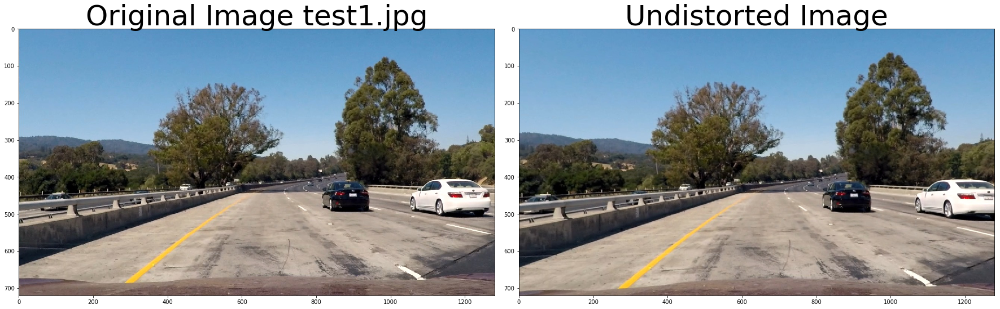

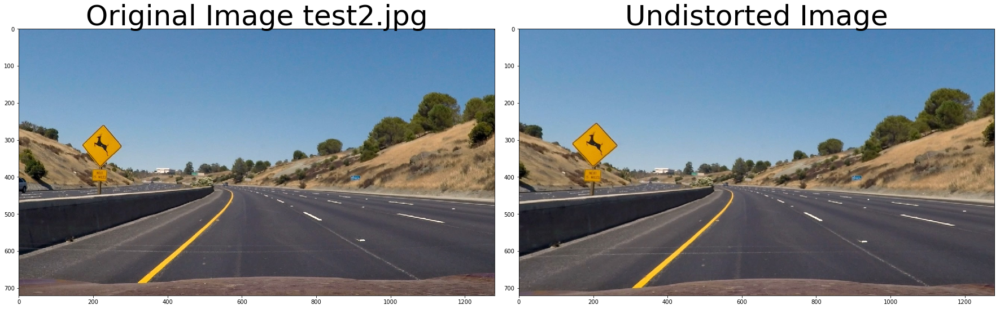

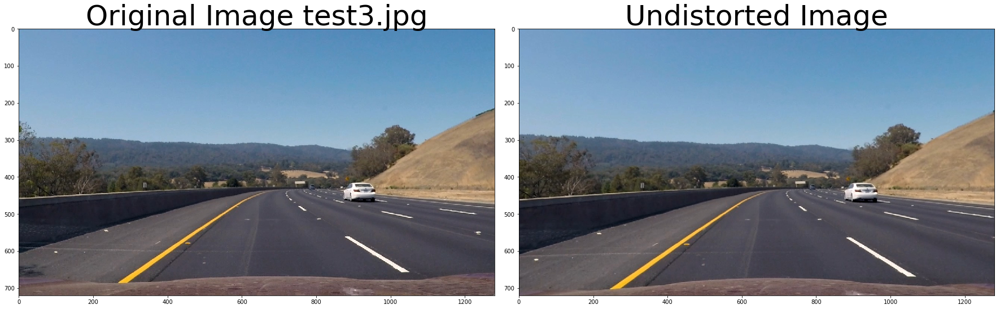

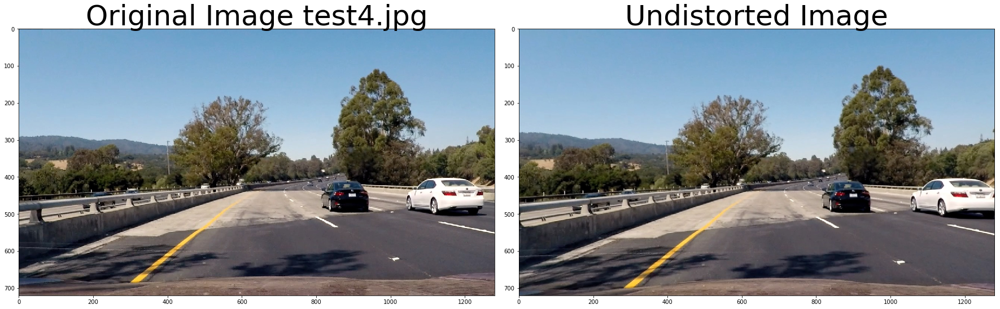

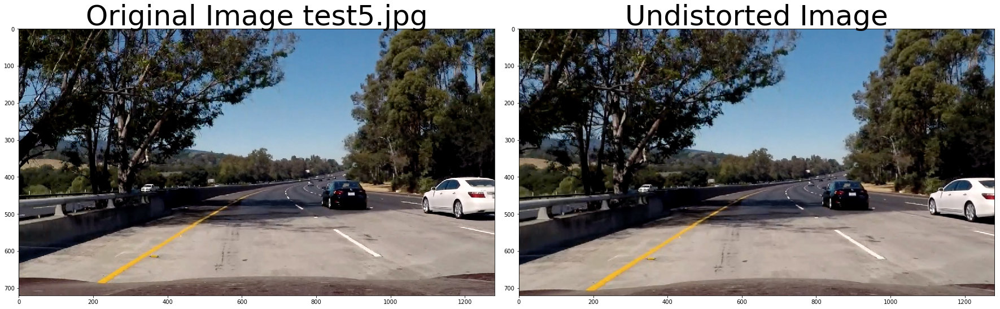

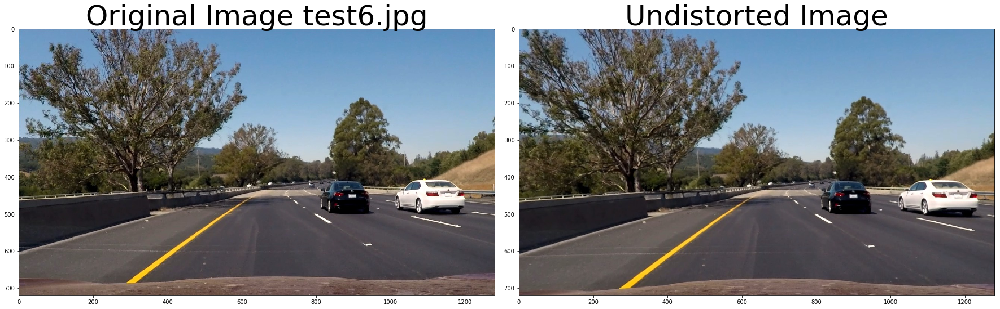

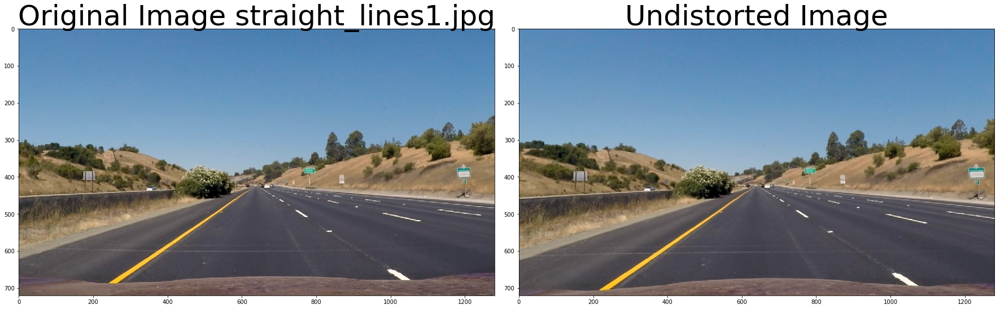

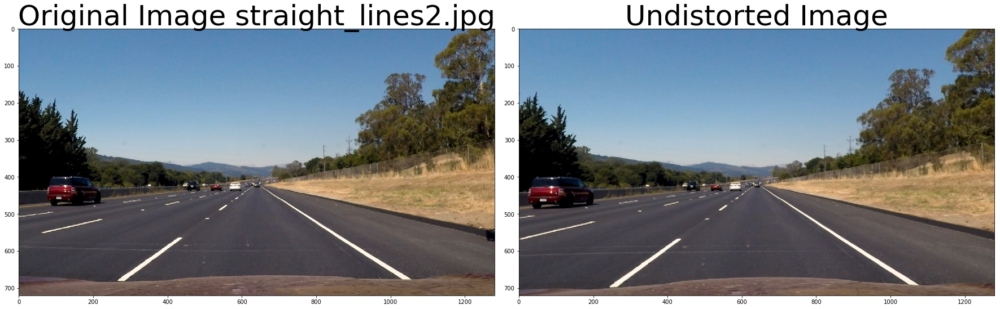

In [4]:
#
# undistorted images 
#
images = glob.glob( '../test_images/test*.jpg' )
images.extend( glob.glob( '../test_images/straight_lines*.jpg' ))
undistorted_images = []
calibrate_camera_flag = True
for fname in images:
    img = cv2.imread(fname)
    if calibrate_camera_flag:
        calibrate_camera_flag = False
        mtx, dist = calibrate_camera(img, objpoints, imgpoints)
        
    #undistorted = cal_undistort(img, objpoints, imgpoints)
    undistorted = undistort_image( img, mtx, dist) 
    
    undistorted_images.append(undistorted)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image ' + fname.split('\\')[-1], fontsize=50)
    ax2.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



## Threshold Binary Image Use Color Transforms Combined With Gradients


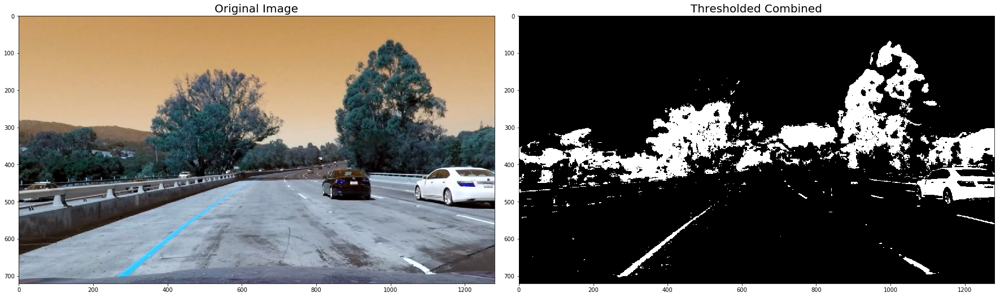

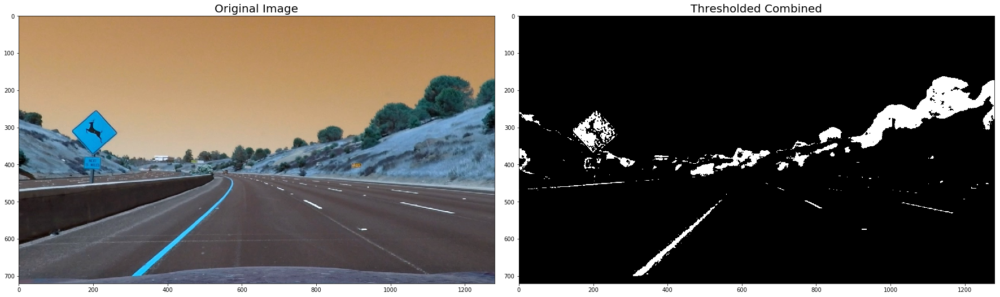

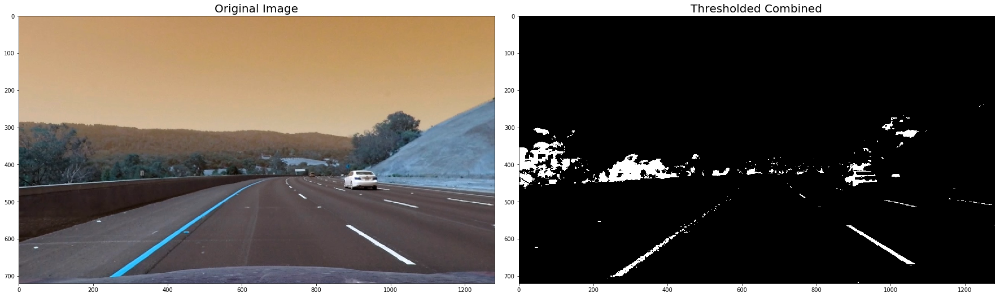

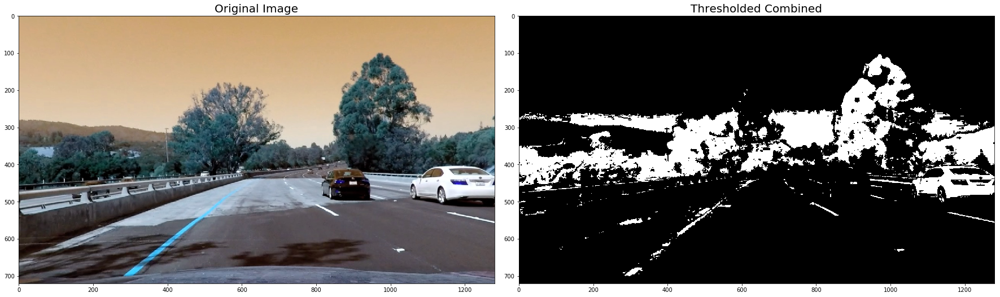

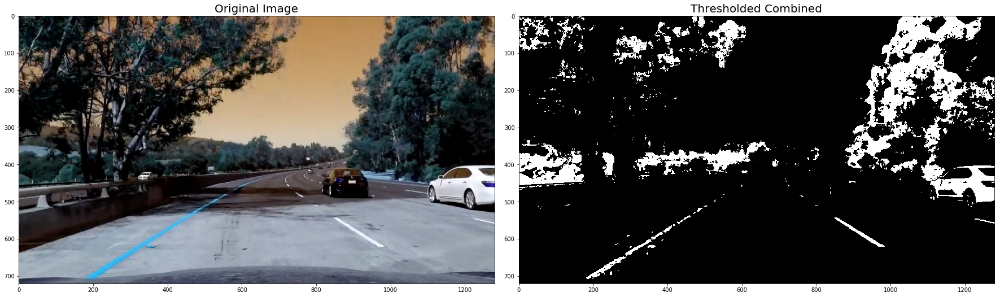

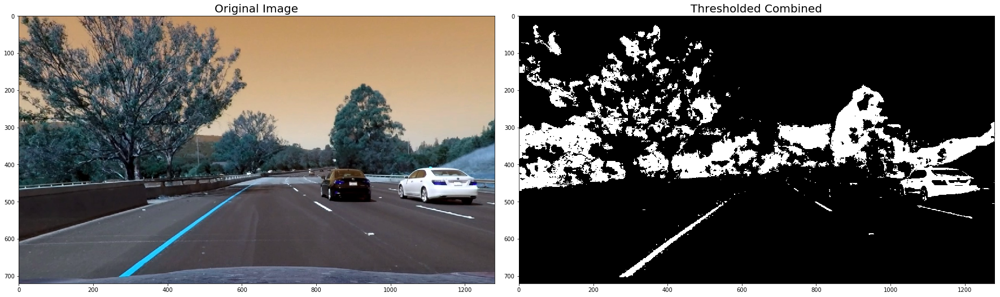

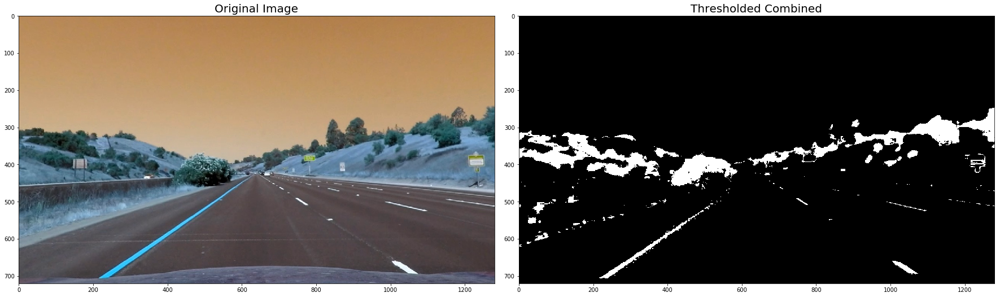

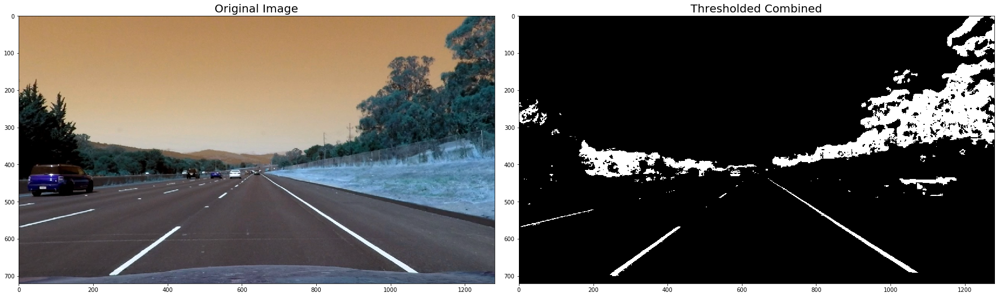

In [36]:
def thresh_binary_yellow_and_white(img, is_RGB=True,yellow_thresh=((20, 35), (20,255), (20, 255)), white_l_thresh=(200, 255), sx_thresh=(10, 25)):
    img = np.copy(img)    
    # Convert to HLS color space and separate the V channel
    if not is_RGB:
        hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS).astype(np.float)
    else:
        hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
     # Threshold color channel        
    yellow_binary = np.zeros_like(s_channel)
    yellow_binary[(h_channel > yellow_thresh[0][0]) & (h_channel <= yellow_thresh[0][1]) &
                  (l_channel > yellow_thresh[1][0]) & (l_channel <= yellow_thresh[1][1]) &
                  (s_channel > yellow_thresh[2][0]) & (s_channel <= yellow_thresh[2][1])] = 1
    white_binary = np.zeros_like(s_channel)
    white_binary[(l_channel > white_l_thresh[0]) & (l_channel <= white_l_thresh[1])] = 1
    
    combined = np.zeros_like(s_channel)
    combined[ (yellow_binary == 1) | ((white_binary == 1) )] = 1 
    
    return combined
    
def thresh_binary(img, s_thresh=(30, 255), sx_thresh=(30, 255)):
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(s_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel > s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    combined = np.zeros_like(sxbinary)
    combined[ (sxbinary == 1)] = 1    
    return combined 
    
# Run the function
   
for image in undistorted_images:
    # Apply each of the thresholding functions
    #combined = thresh_binary(image)
    combined = thresh_binary_yellow_and_white(image, is_RGB=False)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Thresholded Combined', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    


### Apply a perspective transform to Rectify Binary Image
Use the straight line images for reference


In [6]:
# save the undistorted straight line images and define the source and destinetion cooridinate
#cv2.imwrite("undistorted_straightline1.png", undistorted_images[6] )
cv2.imwrite("undistorted_straightline2.png", undistorted_images[7] )


True

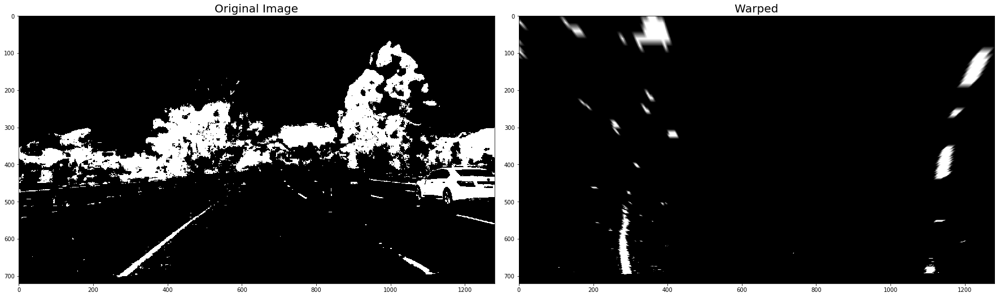

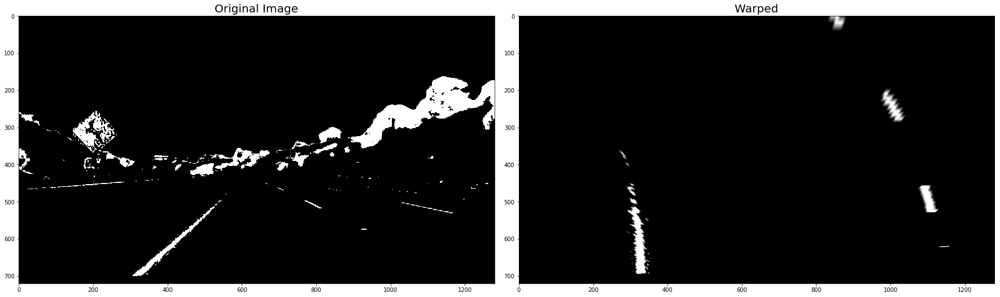

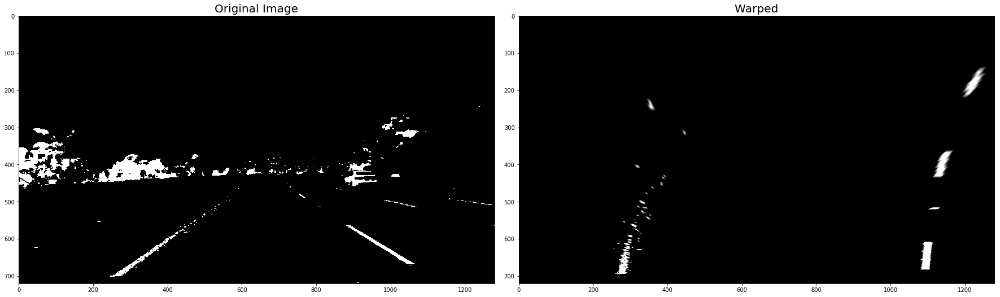

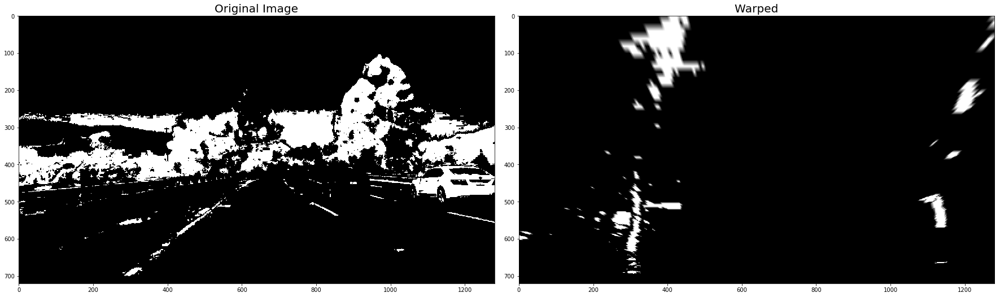

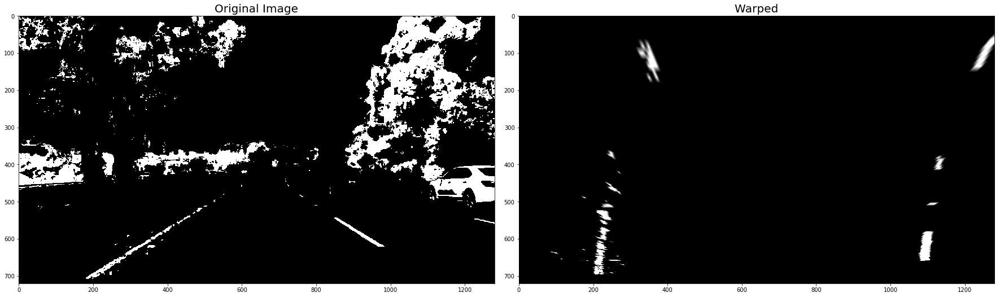

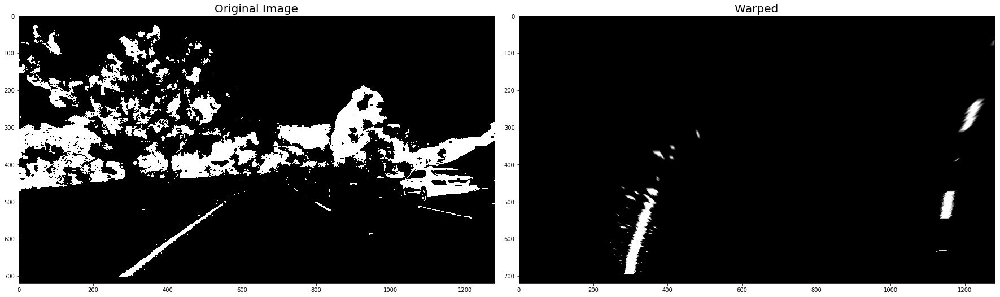

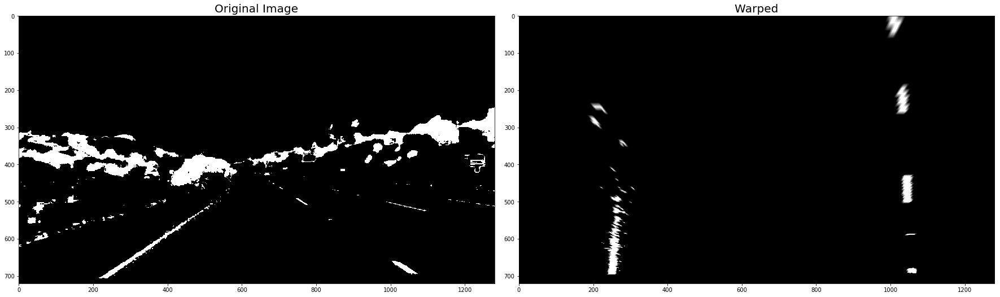

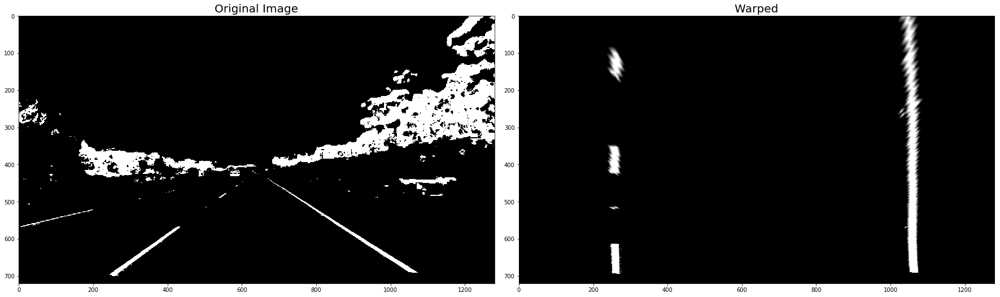

In [7]:
# print(undistorted_images[6].shape)
#
# manually determine the warp coordinates from the undistorted straight line image
#
src = np.float32([
    [588, 455],  
    [697, 455],  
    [1055, 690], 
    [ 261, 690]])
    

dst = np.float32([
    [261,  100],  
    [1055, 100],    
    [1055, 690],
    [261,  690]])

M_Perspective = cv2.getPerspectiveTransform(src, dst)

warped_binary_images = []
for undist in undistorted_images:  # straight line images
    undist = thresh_binary_yellow_and_white( undist, is_RGB=False )
    img_size = (undist.shape[1], undist.shape[0])
    warped = cv2.warpPerspective(undist, M_Perspective, img_size, flags=cv2.INTER_LINEAR)
    warped_binary_images.append( warped)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(undist, cmap='gray')
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(warped, cmap='gray')
    ax2.set_title('Warped', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

### Detect lane pixels and fit to find the lane boundary


#### Slide Window Search
1. Use histogram to find base locations of lane lines.
2. Use slide windows from the base location upward to find the connected line.

In [8]:
# margin - the width of the windows +/- margin
# minpix - minimum number of pixels found to recenter window
#
def slide_window_search( binary_warped, nwindows = 9, margin = 100, minpix = 50, visualize_flag = True):
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    if visualize_flag:
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255        
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    ## for left and right 
    for x_current, lane_inds, dot_color in zip( 
        [leftx_current, rightx_current], [left_lane_inds, right_lane_inds], [(0,255,0), ((0,255,0))]):
        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
        
            win_x_low = x_current - margin
            win_x_high = x_current + margin

            # Draw the windows on the visualization image
            if visualize_flag:
                cv2.rectangle(out_img,(win_x_low+1,win_y_low+1),(win_x_high-1,win_y_high),dot_color, thickness=4) 

            # Identify the nonzero pixels in x and y within the window
            good_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                              (nonzerox >= win_x_low) & (nonzerox < win_x_high)).nonzero()[0]
            # Append these indices to the lists
            lane_inds.append(good_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_inds) > minpix:
                x_current = np.int(np.mean(nonzerox[good_inds]))
                
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    # fit polynomial    
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    if visualize_flag:
        # draw found points
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]        
        return left_fit, right_fit, out_img
    else:
        return left_fit, right_fit

#### Nearby Search

Once the lines are found, in next frame only need to find new lines in the nearby windows of the fit lines.

In [9]:
def nearby_search_from_nonzero(nonzerox, nonzeroy, prev_fit, margin):
    lane_inds = ((nonzerox > (prev_fit[0]*(nonzeroy**2) + prev_fit[1]*nonzeroy + prev_fit[2] - margin)) & 
                      (nonzerox < (prev_fit[0]*(nonzeroy**2) + prev_fit[1]*nonzeroy + prev_fit[2] + margin))) 

    # Extract left and right line pixel positions
    foundx = nonzerox[lane_inds]
    foundy = nonzeroy[lane_inds] 
    ## Fit a second order polynomial to each
    found_fit = np.polyfit(foundy, foundx, 2)    
    return found_fit

def nearby_search(binary_warped, left_fit, right_fit, margin=100):
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    new_left_fit = nearby_search_from_nonzero(nonzerox, nonzeroy, left_fit, margin )
    new_right_fit = nearby_search_from_nonzero(nonzerox, nonzeroy, right_fit, margin )
    return new_left_fit, new_right_fit

## Generate x and y values for plotting
#ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
#left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
#right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]


c:\users\michael tien\miniconda3\lib\site-packages\ipykernel\__main__.py:5: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


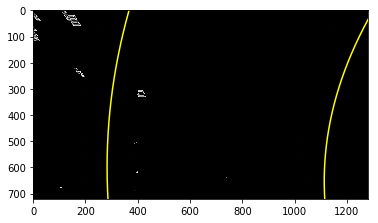

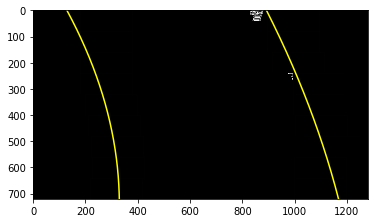

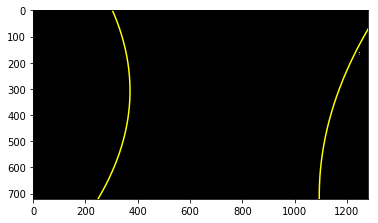

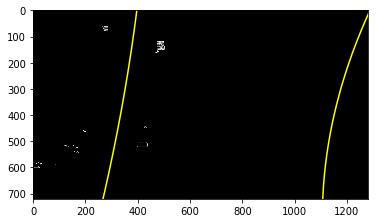

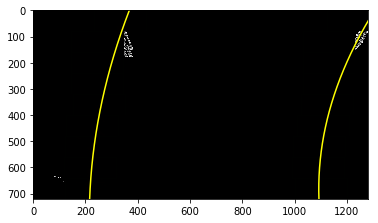

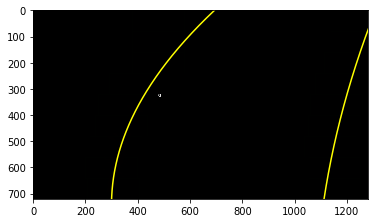

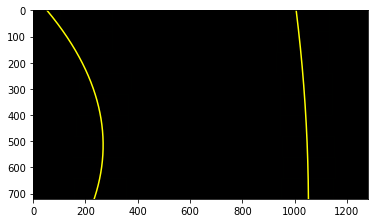

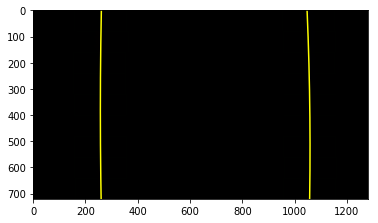

In [10]:
for binary_warped in warped_binary_images:    
    
    left_fit, right_fit, out_img = slide_window_search( binary_warped)    
    
    ### Visualization
    # Extract left and right line pixel positions
    # create y values
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )        
    # find x value for every y values
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)    
    plt.show()
    
    

### Curvature Calculation
For polynomial 
\begin{equation}
f(y)=Ay^2 + By + c
\end{equation}

Radius of Curvature is defined as 
\begin{equation}
Rcurve = \frac{[1+(\frac{dx}{dy})^{2}]^{3/2}}{\left | \frac{d^2x}{d^2y} \right |})
\end{equation}

So the result is
\begin{equation}
Rcurve = \frac{(1+(2Ay+B)^2)^{3/2}}{\left |2A \right |}
\end{equation}

In order to measure the curvature near the car, y value is at the bottom of image, that is, image.shape[0]-1.  

In [11]:
def curvature( poly_fit, y_eval):
    curverad = ((1 + (2*poly_fit[0]*y_eval + poly_fit[1])**2)**1.5) / np.absolute(2*poly_fit[0])
    return curverad

** Curvature in Real Word Space **

The value of radius of curvature we used to calculate curvature so far based on pixel values.  In real world space, we need convert back to meters according to measurement of pictures.  

According to  U.S. regulations that require a minimum lane width of 12 feet or 3.7 meters, and the dashed lane lines are 10 feet or 3 meters long each, we define the conversion factor as follows,

In [12]:
#ym_per_pix = 30/720 # meters per pixel in y dimension
ym_per_pix = 60/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

***The Slide Window and Nearby Search are redefined as follows for add Radius of Curvature ***

In [13]:
def slide_window_search2( binary_warped, xm_per_pix, ym_per_pix, nwindows = 9, margin = 100, minpix = 50, visualize_flag = False):
    # Create an output image to draw on and  visualize the result
    if visualize_flag:
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255        
        
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    ## for left and right 
    for x_current, lane_inds, dot_color in zip( 
        [leftx_current, rightx_current], [left_lane_inds, right_lane_inds], [(0,255,0), ((0,255,0))]):
        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
        
            win_x_low = x_current - margin
            win_x_high = x_current + margin

            # Identify the nonzero pixels in x and y within the window
            good_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                              (nonzerox >= win_x_low) & (nonzerox < win_x_high)).nonzero()[0]
            # Append these indices to the lists
            lane_inds.append(good_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_inds) > minpix:
                x_current = np.int(np.mean(nonzerox[good_inds]))
                
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    if ( len(lefty) == 0) or (len(righty) == 0):
        ## nothing found
        return None, None, None, None
    # fit polynomial   
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    real_left_fit = np.polyfit(lefty * ym_per_pix, leftx * xm_per_pix, 2)
    real_right_fit = np.polyfit(righty * ym_per_pix, rightx * xm_per_pix, 2)
    
    if visualize_flag:
        # draw found points
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]        
    
    # calcculate curvature
    y_value =  (binary_warped.shape[0]-1) * ym_per_pix
    left_curverad = curvature(real_left_fit, y_value)
    right_curverad = curvature(real_right_fit, y_value)  
    # use the more confident curverad
    if len(leftx) > len(rightx):
        right_curverad = left_curverad
    else:
        left_curverad = right_curverad
    if visualize_flag:
        return left_fit, right_fit, left_curverad, right_curverad, out_img
    else:
        return left_fit, right_fit, left_curverad, right_curverad
    
def nearby_search_from_nonzero2(nonzerox, nonzeroy, prev_fit, margin, xm_per_pix, ym_per_pix, max_y_value):
    lane_inds = ((nonzerox > (prev_fit[0]*(nonzeroy**2) + prev_fit[1]*nonzeroy + prev_fit[2] - margin)) & 
                      (nonzerox < (prev_fit[0]*(nonzeroy**2) + prev_fit[1]*nonzeroy + prev_fit[2] + margin))) 

    # Extract left and right line pixel positions
    foundx = nonzerox[lane_inds]
    foundy = nonzeroy[lane_inds] 
    ## Fit a second order polynomial to each
    if len(foundx) == 0:
        return None, None, len(foundx)
    found_fit = np.polyfit(foundy, foundx, 2)    
    ## find curvature
    real_fit = np.polyfit(foundy * ym_per_pix, foundx * xm_per_pix, 2)
    curverad = curvature(real_fit, max_y_value * ym_per_pix)
    return found_fit, curverad, len(foundx)

def nearby_search2(binary_warped, left_fit, right_fit, xm_per_pix, ym_per_pix, margin=100):
    nonzero = binary_warped.nonzero()
    max_y_value = binary_warped.shape[0]-1
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    new_left_fit, left_curvature, left_count = nearby_search_from_nonzero2(nonzerox, nonzeroy, left_fit, margin, xm_per_pix, ym_per_pix, max_y_value )
    new_right_fit, right_curvature, right_count = nearby_search_from_nonzero2(nonzerox, nonzeroy, right_fit, margin, xm_per_pix, ym_per_pix, max_y_value )
    if left_count > right_count:
        right_curvature = left_curvature
    else:
        left_curvature = right_curvature
    return new_left_fit, new_right_fit, left_curvature, right_curvature


***The curvatures of warped images are displayed as follows.***

c:\users\michael tien\miniconda3\lib\site-packages\ipykernel\__main__.py:6: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


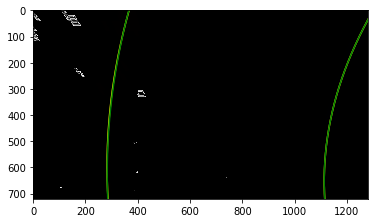

Old Curvature  2815.84168981 m 2815.84168981 m
New Curvature  3065.07413383 m 3065.07413383 m


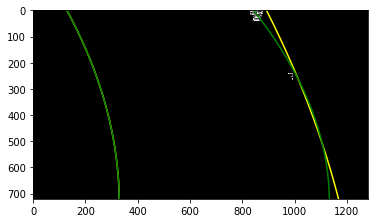

Old Curvature  1807.82499839 m 1807.82499839 m
New Curvature  1221.68293501 m 1221.68293501 m


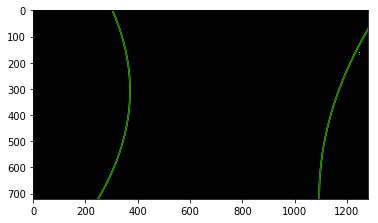

Old Curvature  1431.0664394 m 1431.0664394 m
New Curvature  1416.53966224 m 1416.53966224 m


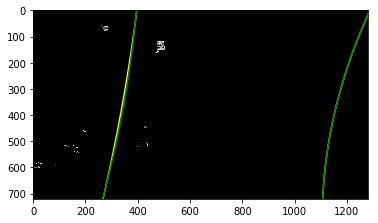

Old Curvature  9098.52305906 m 9098.52305906 m
New Curvature  5276.89204349 m 5276.89204349 m


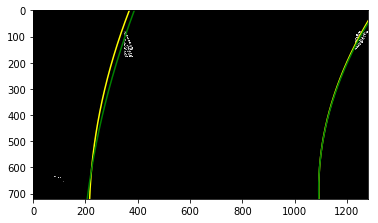

Old Curvature  2718.33767773 m 2718.33767773 m
New Curvature  3850.51122102 m 3850.51122102 m


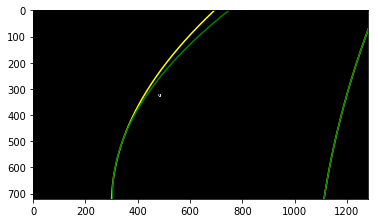

Old Curvature  921.290227435 m 921.290227435 m
New Curvature  741.767196743 m 741.767196743 m


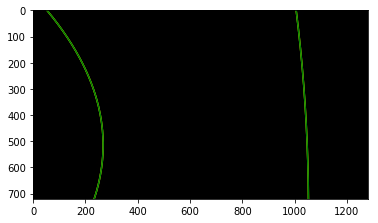

Old Curvature  8027.90112487 m 8027.90112487 m
New Curvature  8027.90112487 m 8027.90112487 m


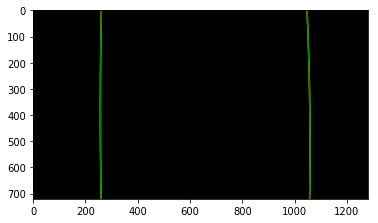

Old Curvature  16218.0248775 m 16218.0248775 m
New Curvature  16218.0248775 m 16218.0248775 m


In [14]:
for binary_warped in warped_binary_images:    
    
    left_fit, right_fit, left_curverad, right_curverad, out_img = slide_window_search2( 
        binary_warped, xm_per_pix, ym_per_pix, visualize_flag = True )
    
    new_left_fit, new_right_fit, new_left_curverad, new_right_curverad = nearby_search2(
        binary_warped, left_fit, right_fit, xm_per_pix, ym_per_pix, margin=100)
    ### Visualization
    # create y values
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )        
    # find x value for every y values
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    new_left_fitx = new_left_fit[0]*ploty**2 + new_left_fit[1]*ploty + new_left_fit[2]
    new_right_fitx = new_right_fit[0]*ploty**2 + new_right_fit[1]*ploty + new_right_fit[2]
        
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.plot(new_left_fitx, ploty, color='green')
    plt.plot(new_right_fitx, ploty, color='green')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)    
    plt.show()
    print('Old Curvature ', left_curverad, 'm', right_curverad, 'm')
    print('New Curvature ', new_left_curverad, 'm', new_right_curverad, 'm')    

### Offset of Lane Center

Assume camera is mounted at the center of the car and the land center is the center between the lane lines.  The offset of the lane center from the center of the image (converted from pixels to meters) is your distance from the center of the lane.


In [15]:
def camera_offset(left_fit, right_fit, center_pix, y_value, xm_per_pix0 = xm_per_pix):
    left_lane_x = left_fit[0]*y_value**2 + left_fit[1]*y_value + left_fit[2]
    right_lane_x = right_fit[0]*y_value**2 + right_fit[1]*y_value + right_fit[2]
    lane_center = (left_lane_x + right_lane_x) // 2
    offset_meter = (center_pix - lane_center) * xm_per_pix0
    return offset_meter


c:\users\michael tien\miniconda3\lib\site-packages\ipykernel\__main__.py:5: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


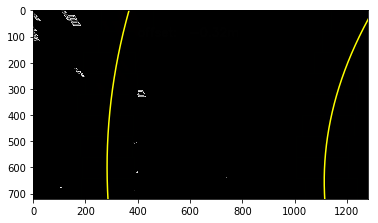

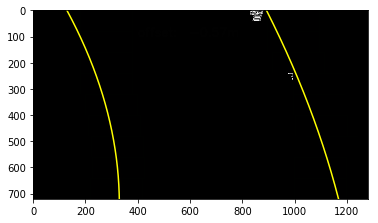

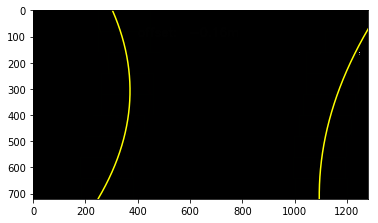

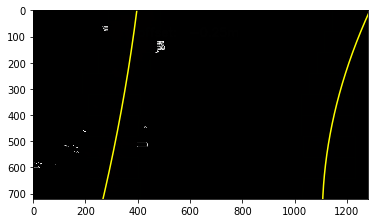

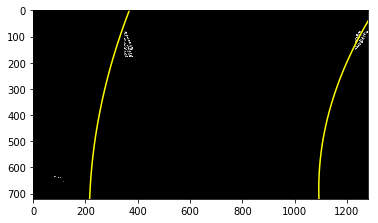

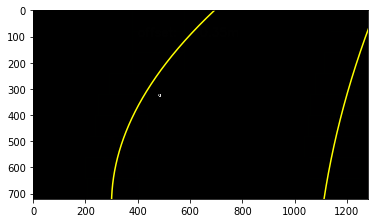

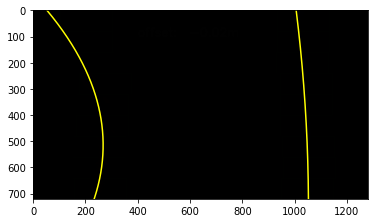

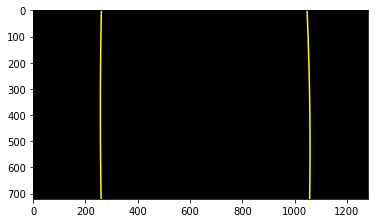

In [16]:
for binary_warped in warped_binary_images:    
    
    left_fit, right_fit, out_img = slide_window_search( binary_warped, visualize_flag = True )    
    
    ### Visualization
    # create y values
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )        
    # find x value for every y values
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    y_value =  (out_img.shape[0]-1)    
    center_pix = out_img.shape[1] // 2
    offset = camera_offset( left_fit, right_fit, center_pix, y_value, xm_per_pix )
    hint_text = "offset: {0:6.2f}m".format( offset)
        
    # offset    
    text_color = (255,255,255)
    text_font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 1.5
    text_thinkness = 6
    cv2.putText(out_img, hint_text, (400,100), text_font,font_scale,text_color, text_thinkness)
        
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)    
    plt.show()


### Line Tracking

A clas Line() is created to keep track of line properties, like radius of curvature,  polynomial fit coefficients.  Besides, some functions are defined for 

In [17]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
#        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = np.array([]).reshape((0,3))
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        

* Sanity Check

   * Checking that they have similar curvature
   * Checking that they are separated by approximately the right distance horizontally
   * Checking that they are roughly parallel

In [50]:
# default tolerence of difference is 0.5 meter 
# convert to pixels
default_tolerence = 0.53 / xm_per_pix
def sanity_check(left_fit, right_fit, height_px, tolerence_px = default_tolerence, nwindows=9):
    # check the parallel of lanes
    dy = np.linspace(height_px * 1 / 4, height_px-1, nwindows ) 
    left_fitx =  left_fit[0]*dy**2 +  left_fit[1]*dy +  left_fit[2]
    right_fitx = right_fit[0]*dy**2 + right_fit[1]*dy + right_fit[2]
    distance_x = right_fitx - left_fitx
    min_value = min( distance_x)
    max_value = max( distance_x)
    #if ( (max_value - min_value) > tolerence_px):
    #    print( "difference = {0}".format(max_value - min_value))
    return (max_value - min_value) <= tolerence_px
    

* Look-Ahead Filter

   Once line are found, the line in next frame is nearby so that no need to search again.  

* Reset

   If loses lines in next several frames, we should search the lines from scratch using histogram and slide windows.

* Smooth

   Take average measurement from past n frames to draw the lane positions.  

* Draw

   I use the best fit coefficients to generate the coordinates of lane lines, draw a polygon with these coordinates in the warped bitmap.  The wraped bitbmp image is transferred back to unwarp bitmap and draw on the original image.
The radius curvature and offset of car are drawn on the top of original image, too.

In [19]:
def lane_image(left_fit, right_fit, image_shape, Minv, draw_color=(0,255,0)):
    warp_zero = np.zeros(shape=image_shape).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )        
    # find x value for every y values
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), draw_color)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image_shape[1], image_shape[0])) 
    return newwarp

### Test Lane Images

c:\users\michael tien\miniconda3\lib\site-packages\ipykernel\__main__.py:6: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


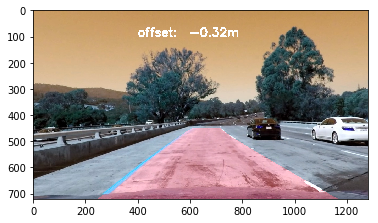

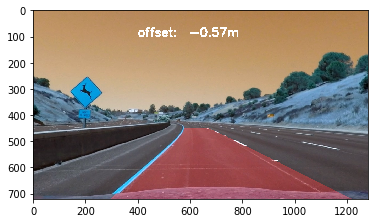

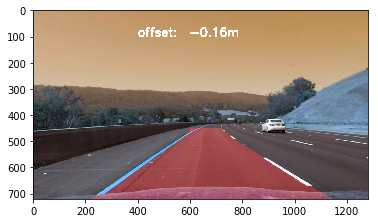

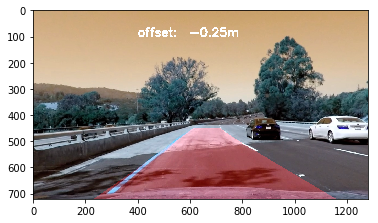

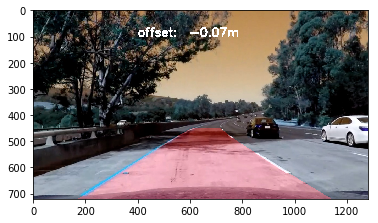

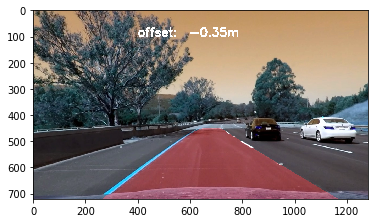

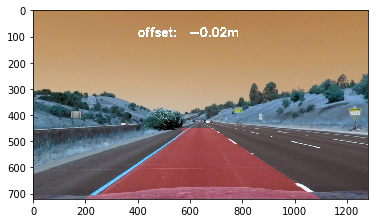

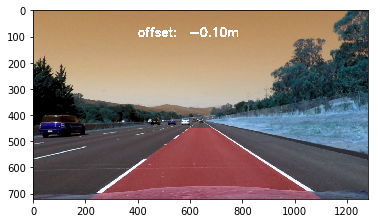

In [20]:
src = np.float32([
    [588, 455],  
    [697, 455],  
    [1055, 690], 
    [ 261, 690]])
    
dst = np.float32([
    [261,  100],  
    [1055, 100],    
    [1055, 690],
    [261,  690]])

INV_M_Perspective = cv2.getPerspectiveTransform(dst, src)
# test lane image
for i in range(len(undistorted_images)):
    undist = undistorted_images[i]
    binary_warped = warped_binary_images[i]
    left_fit, right_fit, left_curverad, right_curverad = slide_window_search2( binary_warped, xm_per_pix, ym_per_pix, visualize_flag = False )    
    newwarp = lane_image(left_fit, right_fit, binary_warped.shape, INV_M_Perspective, draw_color=(255, 0 ,0))
    ### Visualization
    out_image = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    y_value =  (binary_warped.shape[0]-1)    
    center_pix = binary_warped.shape[1] // 2
    offset = camera_offset( left_fit, right_fit, center_pix, y_value, xm_per_pix )
    hint_text = "offset: {0:6.2f}m".format( offset)
        
    # offset    
    text_color = (255,255,255)
    text_font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 1.5
    text_thinkness = 6
    cv2.putText(out_image, hint_text, (400,100), text_font,font_scale,text_color, text_thinkness)
        
    plt.imshow(out_image)
#    plt.plot(left_fitx, ploty, color='yellow')
#    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)    
    plt.show()

In [51]:
# Initialization
#
# 1. Get objpoints and imgpoints from previous saved file
#
dist_pickle = pickle.load( open( "calibration_image_points.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]
#
# 2. perspective transform coordinate
#
src = np.float32([
    [588, 455],  
    [697, 455],  
    [1055, 690], 
    [ 261, 690]])
    
dst = np.float32([
    [261,  100],  
    [1055, 100],    
    [1055, 690],
    [261,  690]])

M_Perspective = cv2.getPerspectiveTransform(src, dst)
INV_M_Perspective = cv2.getPerspectiveTransform(dst, src)
# Camera calibration for first frame
calibrate_camera_flag = True
# camera calibration parameters
dist = None
mtx = None
#
# 3. Initialize left and right line object
#
left_line_object = Line()
right_line_object = Line()
def save_filter(left_line, right_line, left_fit, right_fit, left_curverad, right_curverad, filter_size):
    
    left_line.current_fit = np.concatenate(([left_fit], left_line.current_fit), axis=0)[:filter_size]
    right_line.current_fit = np.concatenate(([right_fit], right_line.current_fit), axis=0)[:filter_size]
    # best fit is average of current fit
    left_line.best_fit = np.mean(left_line.current_fit, axis=0)
    right_line.best_fit = np.mean(right_line.current_fit, axis=0)
    # curvature
    left_line.radius_of_curvature, right_line.radius_of_curvature = left_curverad, right_curverad

def process_image(img, 
                  left_line =left_line_object, 
                  right_line = right_line_object, 
                  xm_per_pix0 = xm_per_pix, 
                  ym_per_pix0 = ym_per_pix, 
                  filter_size=6,
                  is_RGB=True):
    # undistore the image 
    global calibrate_camera_flag, mtx, dist
    if calibrate_camera_flag:
        calibrate_camera_flag = False
        mtx, dist = calibrate_camera(img, objpoints, imgpoints)   
    #undist = cal_undistort(img, objpoints, imgpoints)    
    undist = undistort_image(img, mtx, dist)
    # get thresh binary image
    #binary_image = thresh_binary(undist, s_thresh=(30, 255), sx_thresh=(30, 255))
    binary_image = thresh_binary_yellow_and_white(undist, is_RGB)
    # 
    img_size = (binary_image.shape[1], binary_image.shape[0])
    warped_binary = cv2.warpPerspective(binary_image, M_Perspective, img_size, flags=cv2.INTER_LINEAR)
    # center_pix for offset calculation
    center_pix = binary_image.shape[1] // 2    
    # y value at car position
    y_value = binary_image.shape[0]-1
    
    reset_flag = False
    # detect lines
    if left_line.detected: # 
        left_fit, right_fit, left_curverad, right_curverad = nearby_search2(
            warped_binary, left_line.current_fit[0], right_line.current_fit[0], xm_per_pix0, ym_per_pix0 )
        
        if (left_fit is None) or (right_fit is None) or not sanity_check(left_fit, right_fit, binary_image.shape[0]): 
            current_len = left_line.current_fit.shape[0]
            if current_len > 1:
                left_line.current_fit = left_line.current_fit[0:current_len-1]
                right_line.current_fit = right_line.current_fit[0:current_len-1]                
            else:
                # lost lane lines, need to reset
                reset_flag = True
                left_line.detected, right_line.detected = False, False
                left_line.current_fit = np.array([]).reshape((0,3))
                right_line.current_fit = np.array([]).reshape((0,3)) 
        else:
            save_filter(left_line, right_line, left_fit, right_fit, left_curverad, right_curverad, filter_size)
        # car offset
        offset = camera_offset(left_line.best_fit, right_line.best_fit, center_pix, y_value, xm_per_pix0)
    else:
        reset_flag = True
        # use slide windows
    if reset_flag:
        left_fit, right_fit, left_curverad, right_curverad = slide_window_search2( warped_binary, xm_per_pix0, ym_per_pix0, visualize_flag = False )    
    
        if (left_fit is not None) and (right_fit is not None) and sanity_check(left_fit, right_fit, binary_image.shape[0]):
            left_line.detected, right_line.detected = True, True
            # keep filter_size records
            save_filter(left_line, right_line, left_fit, right_fit, left_curverad, right_curverad, filter_size)
            # car offset
            offset = camera_offset(left_line.best_fit, right_line.best_fit, center_pix, y_value, xm_per_pix0)
    
    if left_line.detected:
        # average curvature
        average_curve = int((left_line.radius_of_curvature + right_line.radius_of_curvature) // 2)
        hint_text = "curve: {0:8d}m  offset: {1:6.2f}m".format(average_curve, offset)
        
        ### Visualization
        newwarp = lane_image(left_line.best_fit, right_line.best_fit, warped_binary.shape, INV_M_Perspective)
        out_image = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
        # put curvature, offset    
        text_color = (255,255,255)
        text_font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        line_thinkness = 2
        cv2.putText(out_image, hint_text, (350,100), text_font,font_scale,text_color, line_thinkness)
        return out_image
    else:
        return undist


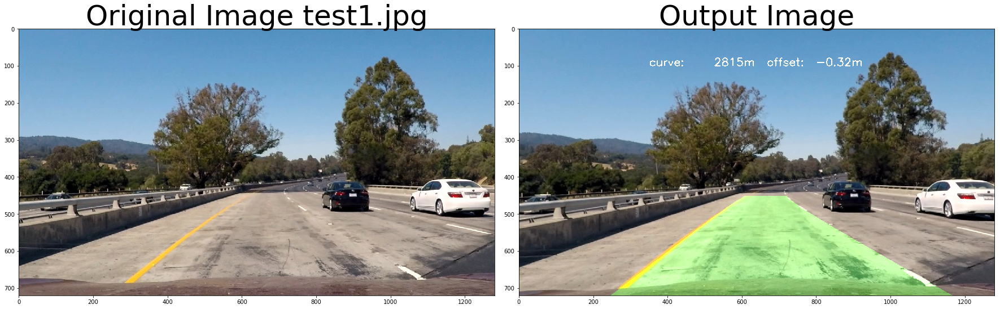

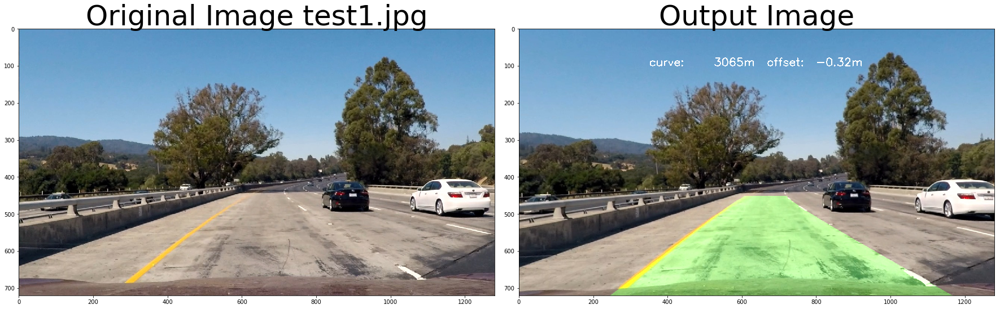

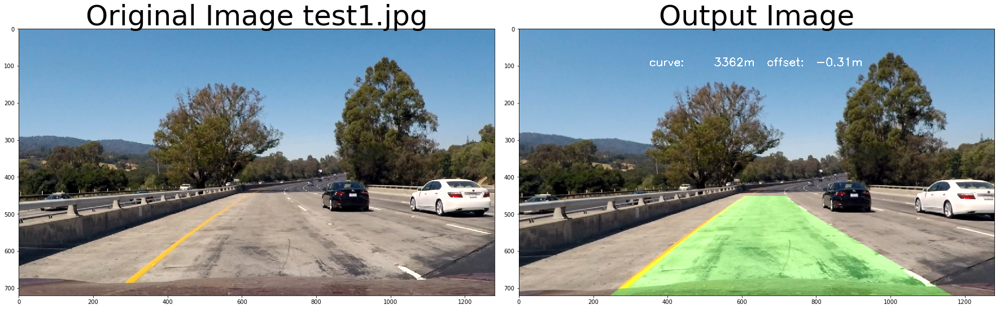

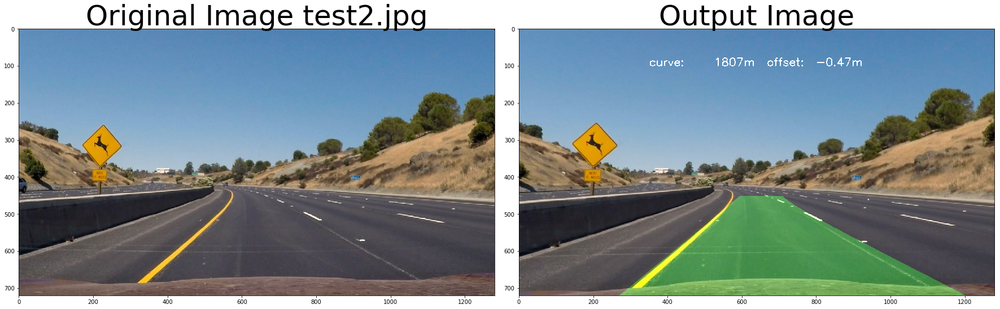

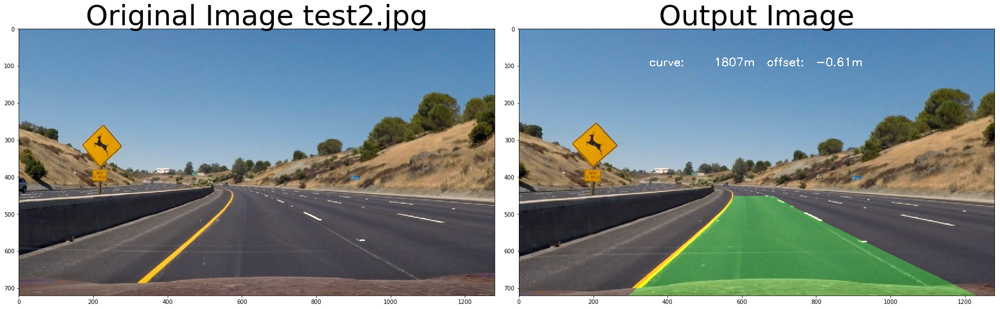

...

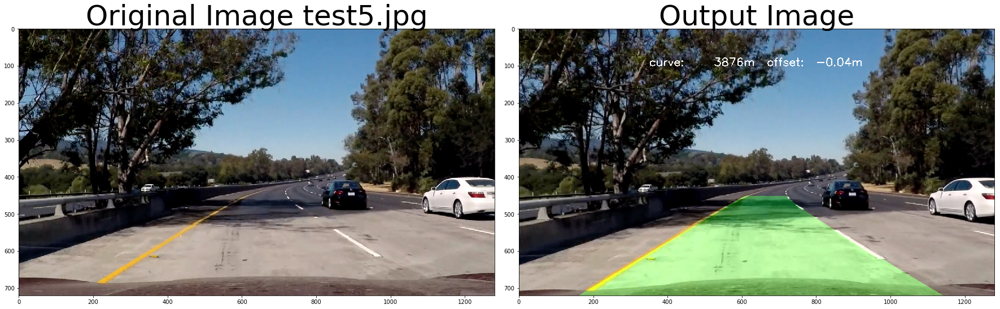

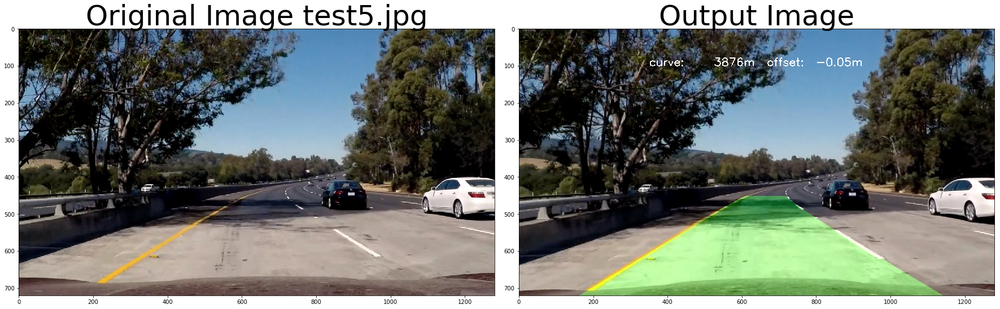

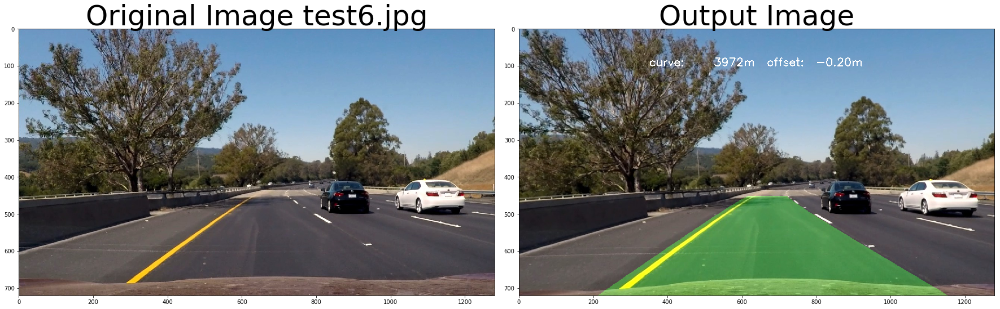

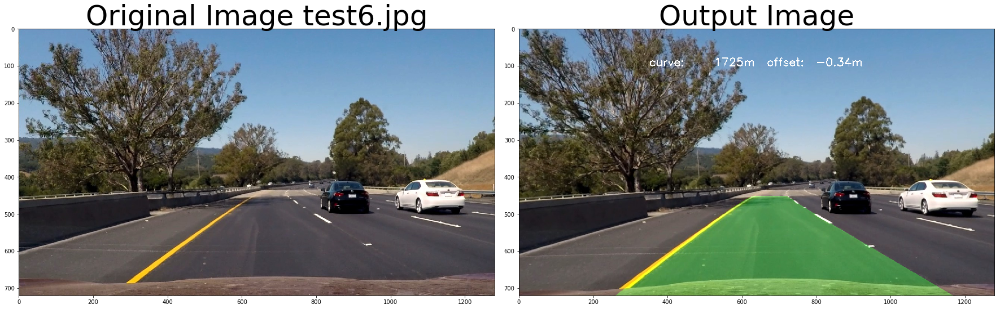

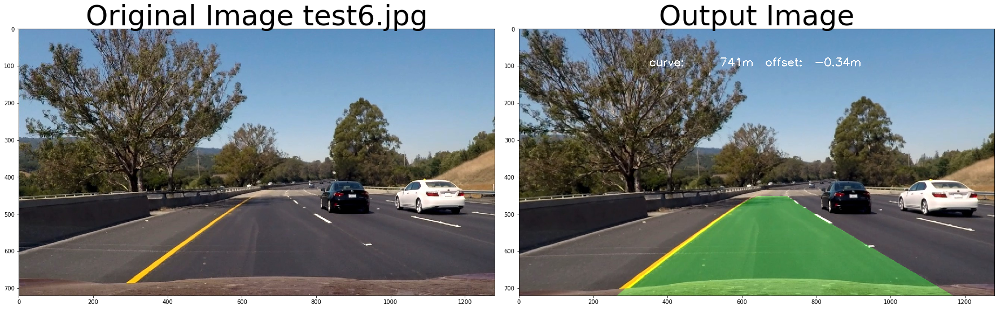

In [39]:
# test pipeline
# initialize line object
left_line_object = Line()
right_line_object = Line()
calibrate_camera_flag = True
images = glob.glob( '../test_images/test*.jpg' )
for fname in images:
    img = cv2.imread(fname)
    # repeat 3 times
    for i in range(3):
        out_image = process_image(img,filter_size=2, is_RGB=False)
        
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax1.set_title('Original Image ' + fname.split('\\')[-1], fontsize=50)
        ax2.imshow(cv2.cvtColor(out_image, cv2.COLOR_BGR2RGB))
        ax2.set_title('Output Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

In [40]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

### Project Video

In [52]:
# initialize line object
left_line_object = Line()
right_line_object = Line()
calibrate_camera_flag = True
project_output = 'project_output.mp4'
clip1 = VideoFileClip('../project_video.mp4')
project_clip = clip1.fl_image(process_image)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video project_output.mp4
[MoviePy] Writing video project_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [02:53<00:00,  7.32it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_output.mp4 

Wall time: 2min 54s


In [53]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))